In [1]:
import xarray as xr
import matplotlib.pyplot as plt
from glob import glob
import numpy as np

In [2]:
# AVISO ftp downloads
ncfile = '/home/jupyter-mrayson/data/SWOT/Karin_prelim/SWOT_L2_LR_SSH_Expert_484_006_20230408T004351_20230408T013433_PIB0_01.nc'

# ncfiles = sorted(glob('/home/jupyter-mrayson/data/SWOT/Karin_prelim/SWOT_L2_LR_SSH_Expert_*.nc'))
ncfiles = sorted(glob('/home/jupyter-mrayson/data/SWOT/Karin_prelim/SWOT_L2_LR_SSH_Expert_*_021*.nc'))
# ncfiles = sorted(glob('/home/jupyter-mrayson/data/SWOT/Karin_prelim_basic/SWOT_L2_LR_SSH_Basic_*_021*.nc'))

# ds = xr.open_dataset(ncfile)
# ds

In [ ]:
ncfiles[-1]

In [ ]:
# from datetime import datetime
# def add_time_dim(xda):
#     xda = xda.expand_dims(satpass = [datetime.now()])
#     return xda

# dsall = xr.open_mfdataset(ncfiles[0:28], preprocess=add_time_dim)
# dsall

In [ ]:
from datetime import datetime
def add_time_dim(xda):
    #xda = xda.expand_dims(satpass = [datetime.now()])
    xda = xda.expand_dims(satpass = [xda.time.mean().values])
    return xda

dsall = xr.open_mfdataset(ncfiles, preprocess=add_time_dim)
dsall

In [ ]:
# ncfiles[16]

In [ ]:
# ds = xr.open_dataset(ncfiles[16])

In [ ]:
# plt.figure()
# plt.plot(ds.longitude[:,0], ds.latitude[:,0],'.')

In [ ]:
ds = dsall
# area = [20, -50, 60, -40]
area = [120, -18, 125, -10] # Kimberley
area = [120, -16, 125, -11] # Kimberley

# area = [110, -44, 125, -34] # Albany
selection = (
    (ds.longitude > area[0]) &
    (ds.longitude < area[2]) &
    (ds.latitude > area[1]) &
    (ds.latitude < area[3]))
selection = selection.compute()
ds_area = ds.where(selection, drop=True)
ds_area

In [2]:

# ds_area.to_netcdf('/home/jupyter-mrayson/data/SWOT/Karin_prelim_complete_calval_browsebasin.nc')

ds_area = xr.open_dataset('/home/jupyter-mrayson/data/SWOT/Karin_prelim_complete_calval_browsebasin.nc')
ds_area

<xarray.Dataset>
Dimensions:                                (satpass: 88, num_lines: 290,
                                            num_pixels: 69, num_sides: 2)
Coordinates:
  * satpass                                (satpass) datetime64[ns] 2023-03-2...
    latitude                               (num_lines, num_pixels) float64 ...
    longitude                              (num_lines, num_pixels) float64 ...
    latitude_nadir                         (satpass, num_lines) float64 ...
    longitude_nadir                        (satpass, num_lines) float64 ...
Dimensions without coordinates: num_lines, num_pixels, num_sides
Data variables: (12/96)
    time                                   (satpass, num_lines, num_pixels) datetime64[ns] ...
    time_tai                               (satpass, num_lines, num_pixels) datetime64[ns] ...
    ssh_karin                              (satpass, num_lines, num_pixels) float64 ...
    ssh_karin_qual                         (satpass, num_lines, num_pixels) float64 ...
    ssh_karin_uncert                       (satpass, num_lines, num_pixels) float32 ...
    ssha_karin                             (satpass, num_lines, num_pixels) float64 ...
    ...                                     ...
    sea_state_bias_cor                     (satpass, num_lines, num_pixels) float32 ...
    sea_state_bias_cor_2                   (satpass, num_lines, num_pixels) float32 ...
    swh_ssb_cor_source                     (satpass, num_lines, num_pixels) float32 ...
    swh_ssb_cor_source_2                   (satpass, num_lines, num_pixels) float32 ...
    wind_speed_ssb_cor_source              (satpass, num_lines, num_pixels) float32 ...
    wind_speed_ssb_cor_source_2            (satpass, num_lines, num_pixels) float32 ...
Attributes: (12/60)
    Conventions:                                   CF-1.7
    title:                                         Level 2 Low Rate Sea Surfa...
    source:                                        Ka-band radar interferometer
    history:                                       2023-08-17T13:16:59Z : Cre...
    platform:                                      SWOT
    reference_document:                            D-56407_SWOT_Product_Descr...
    ...                                            ...
    ellipsoid_flattening:                          0.0033528106647474805
    institution:                                   JPL
    references:                                    V1.1
    equator_time:                                  2023-03-29T15:29:33.610000Z
    equator_longitude:                             125.31
    product_version:                               01

In [ ]:
ii=0

def plot_karin(ii):
    var1, var2= 'ssha_karin', 'ssha_karin_2'
    # var1, var2= 'ssh_karin', 'ssh_karin_2'
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 4))
    plot_kwargs = dict(
    x="longitude",
    y="latitude",
    cmap="RdBu_r",
    vmin=-0.3,
    vmax=0.3,
    cbar_kwargs={"shrink": 0.3},)
    ds_area.isel(satpass=ii)[var1].plot.pcolormesh(ax=ax1, **plot_kwargs)
    ds_area.isel(satpass=ii)[var2].plot.pcolormesh(ax=ax2, **plot_kwargs)
    ax1.set_title(ds_area.satpass.values[ii])
    ax2.set_title('')
    ax2.set_ylabel('')
    plt.tight_layout()

    outfile = '../FIGURES/SWOT/SWOT_Karin_BrowseBasin_{}.png'.format(ds_area.satpass.values[ii].astype(str)[0:10])
    print(outfile)
    plt.savefig(outfile, dpi=150)
    del fig

for ii in range(16):
    plot_karin(ii)

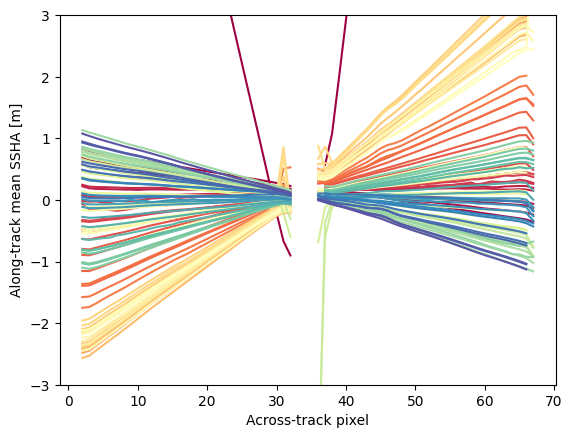

In [6]:
# Compute the along-track average
ssh_mean_along = ds_area['ssha_karin_2'].mean(axis=1)
cmap = plt.colormaps.get_cmap('Spectral')
for ii in range(88):
    plt.plot(ssh_mean_along[ii,:], c=cmap(ii/88.))

plt.ylim(-3,3)
plt.xlabel('Across-track pixel')
plt.ylabel('Along-track mean SSHA [m]')
plt.savefig('../FIGURES/SWOT/SWOT_Karin_Tilt_Error.png', dpi=150)

/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-03-29.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-02.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-03.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-04.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-05.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-06.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-07.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-08.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-09.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-10.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-11.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-12.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-14.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-15.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-16.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-17.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-18.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-19.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-20.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-21.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])
/tmp/ipykernel_181075/1983463130.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 4))


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-22.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-23.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-24.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-25.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-26.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-27.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-28.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-29.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-04-30.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-01.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-02.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-03.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-04.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-05.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-06.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-07.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-09.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-10.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-11.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-12.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-13.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-14.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-15.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-16.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-17.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-24.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-25.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-26.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-27.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-28.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-29.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-05-30.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-01.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-03.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-04.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-05.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-06.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-07.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-08.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-09.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-10.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-11.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-12.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-13.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-14.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-15.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-16.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-17.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-18.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-19.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-20.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])
/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-21.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-22.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-23.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-24.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-25.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-26.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-27.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-06-28.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-02.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-03.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-04.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-05.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-06.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-06.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-07.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-08.png


/tmp/ipykernel_181075/1983463130.py:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_2023-07-09.png


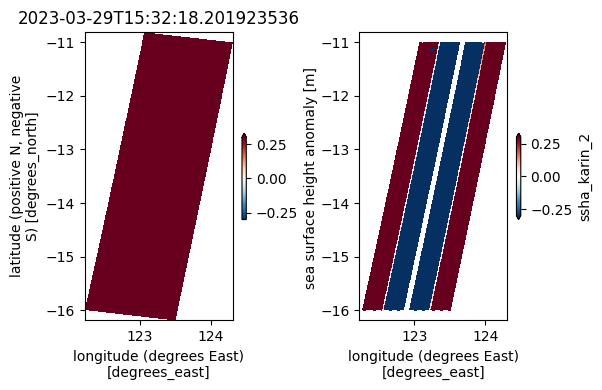

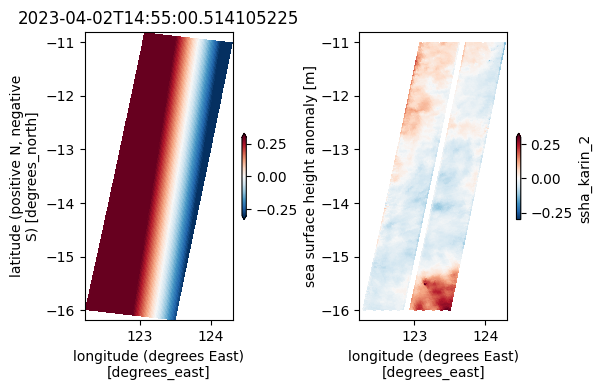

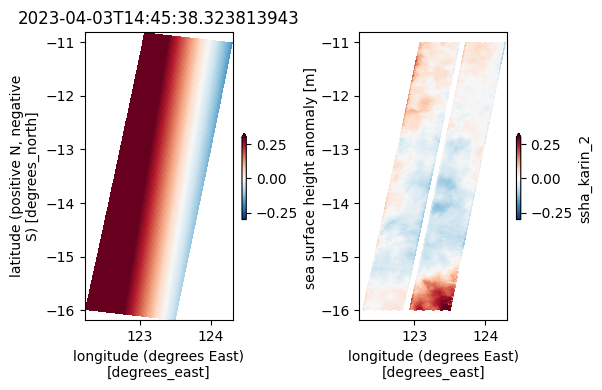

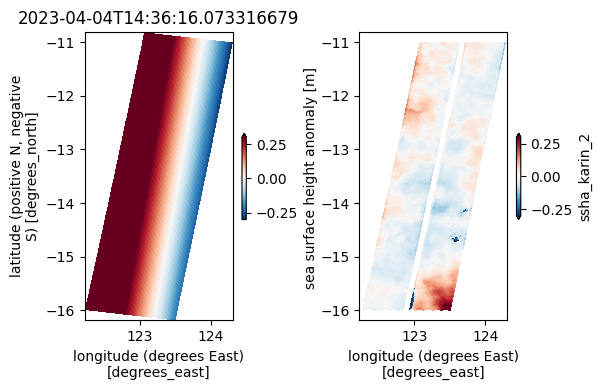

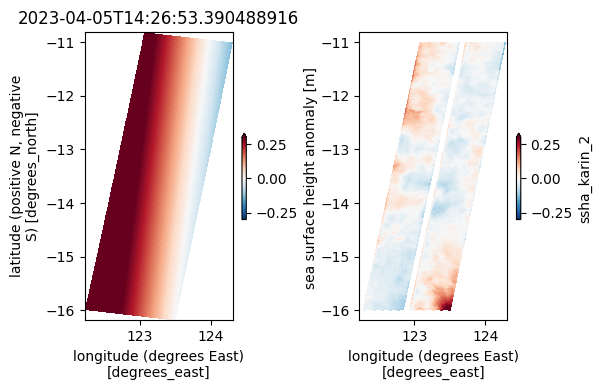

...

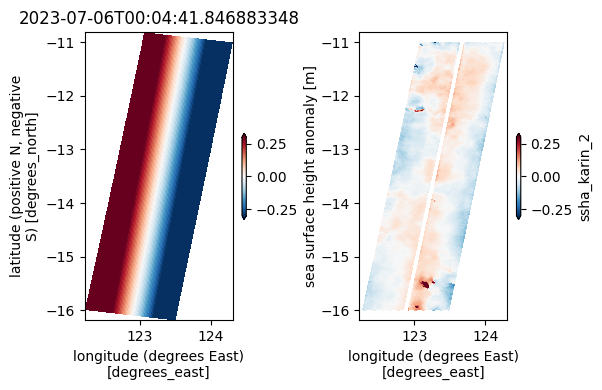

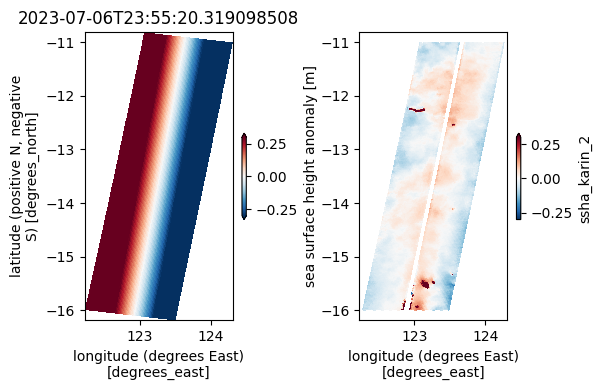

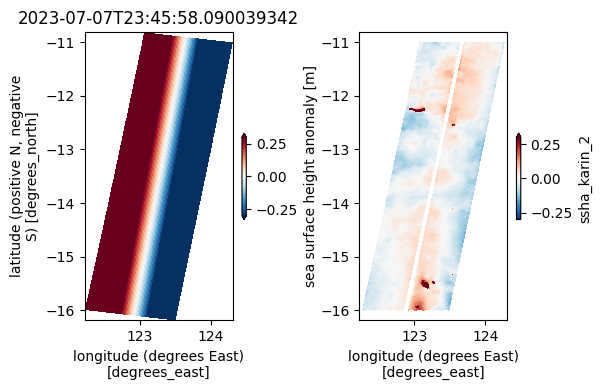

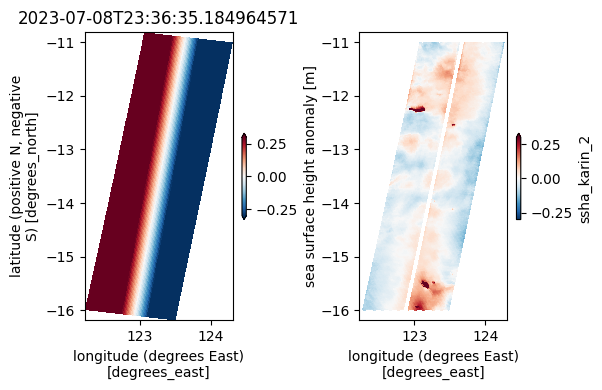

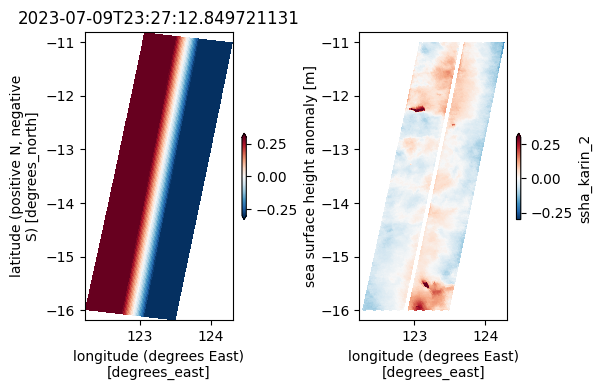

In [8]:
def calc_corrected(ii, plot=True):
    data = ds_area.isel(satpass=ii)['ssha_karin_2']
    
    idx = ~np.isnan(data.values)
    
    X = data.longitude.values[idx]
    Y = data.latitude.values[idx]
    
    N = Y.shape[0]
    
    # Correct the data tilt
    
    A = np.array([ X, Y, np.ones(N,)]).T
    soln,_,_,_ = np.linalg.lstsq(A, data.values[idx])
    
    z_plane = soln[0]*data['longitude'] + soln[1]*data['latitude'] + soln[2]

    data_zplane = data.copy()
    data_zplane[:] = z_plane
    
    # plt.pcolormesh(data['longitude'], data['latitude'], z_plane)
    # plt.colorbar()
    
    data_corrected = data - data_zplane

    if plot:
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 4))
        plot_kwargs = dict(
        x="longitude",
        y="latitude",
        cmap="RdBu_r",
        vmin=-0.3,
        vmax=0.3,
        cbar_kwargs={"shrink": 0.3},)
        #data.plot.pcolormesh(ax=ax1, **plot_kwargs)
        
        #ax1.pcolormesh(data['longitude'], data['latitude'], z_plane, **plot_kwargs2)
        data_zplane.plot.pcolormesh(ax=ax1, **plot_kwargs)
        data_corrected.plot.pcolormesh(ax=ax2, **plot_kwargs)
        ax1.set_title(ds_area.satpass.values[ii])
        ax2.set_title('')
        ax2.set_ylabel('')
        plt.tight_layout()

        outfile = '../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_{}.png'.format(ds_area.satpass.values[ii].astype(str)[0:10])
        print(outfile)
        plt.savefig(outfile, dpi=150)

    return data_corrected

for ii in range(88):
    _,calc_corrected(ii)

../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-03-29.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-02.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-03.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-04.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-05.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-06.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-07.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-08.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-09.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-10.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-11.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-12.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-14.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-15.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-16

/tmp/ipykernel_202452/4159149316.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 4))


../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-22.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-23.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-24.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-25.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-26.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-27.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-28.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-29.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-04-30.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-05-01.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-05-02.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-05-03.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-05-04.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-05-05.png
../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_2023-05-06

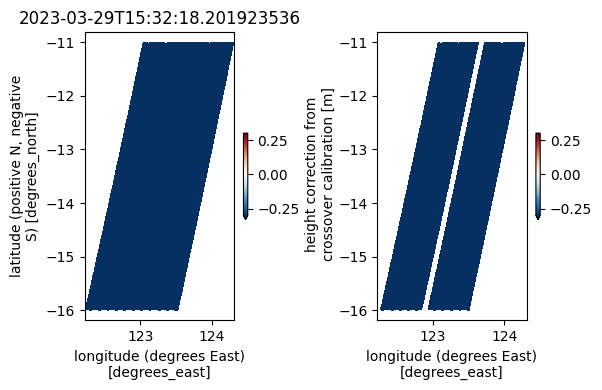

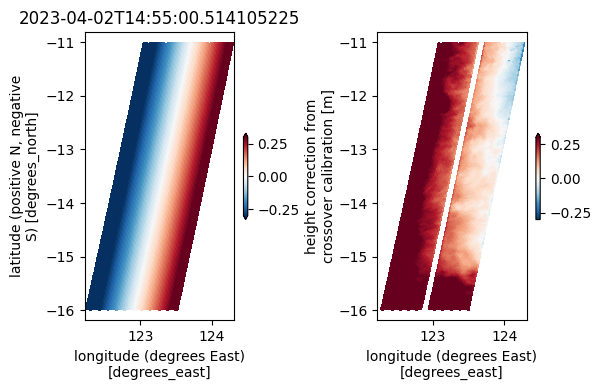

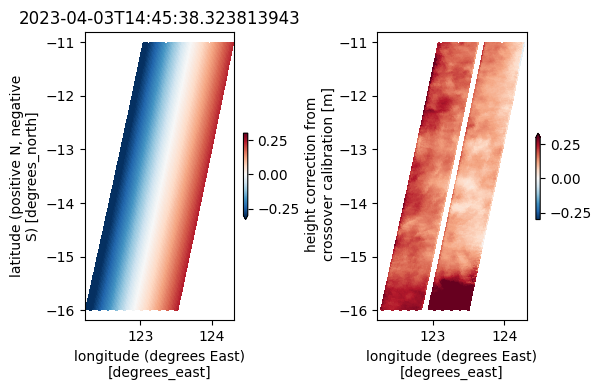

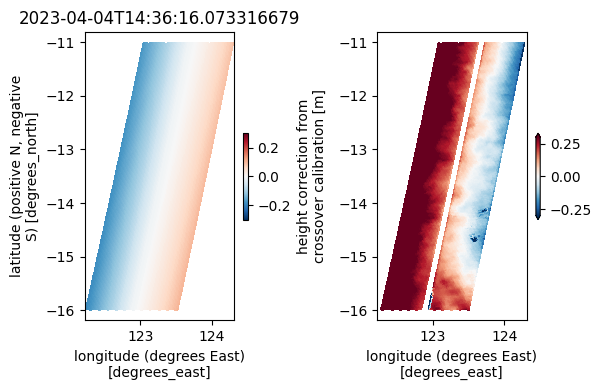

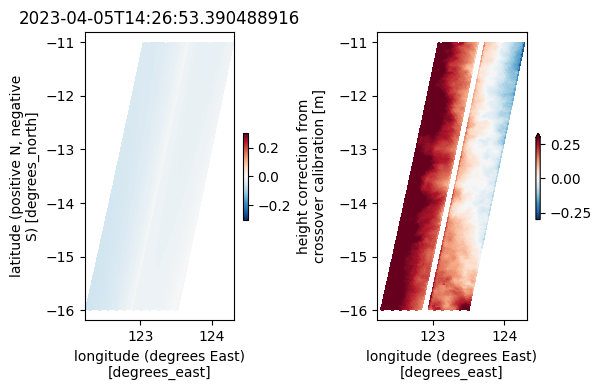

...

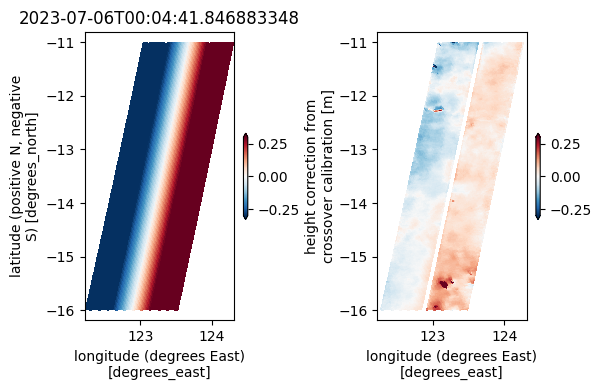

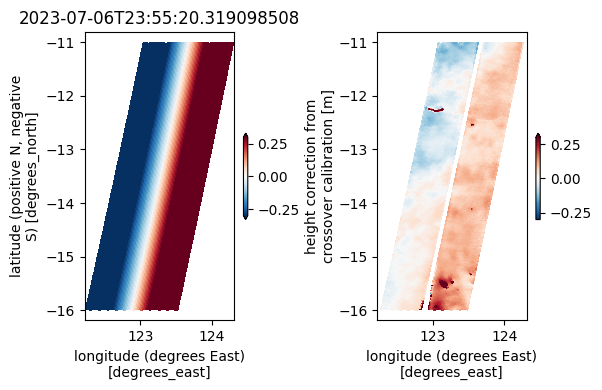

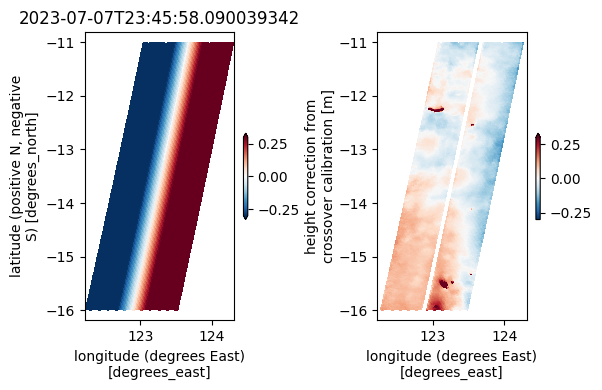

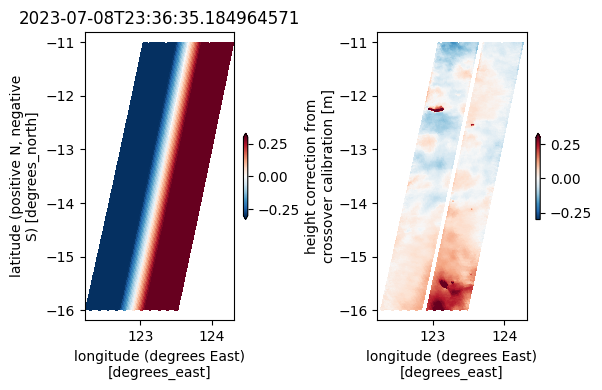

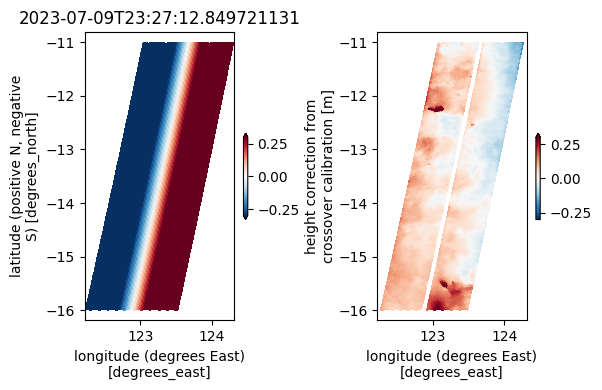

In [3]:
def calc_corrected_v2(ii, plot=True):
    data = ds_area.isel(satpass=ii)['ssha_karin_2']
    
    data_zplane = ds_area.isel(satpass=ii)['height_cor_xover']
    
    # plt.pcolormesh(data['longitude'], data['latitude'], z_plane)
    # plt.colorbar()
    
    data_corrected = data + data_zplane

    if plot:
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 4))
        plot_kwargs = dict(
        x="longitude",
        y="latitude",
        cmap="RdBu_r",
        vmin=-0.3,
        vmax=0.3,
        cbar_kwargs={"shrink": 0.3},)
        #data.plot.pcolormesh(ax=ax1, **plot_kwargs)
        
        #ax1.pcolormesh(data['longitude'], data['latitude'], z_plane, **plot_kwargs2)
        data_zplane.plot.pcolormesh(ax=ax1, **plot_kwargs)
        data_corrected.plot.pcolormesh(ax=ax2, **plot_kwargs)
        ax1.set_title(ds_area.satpass.values[ii])
        ax2.set_title('')
        ax2.set_ylabel('')
        plt.tight_layout()

        outfile = '../FIGURES/SWOT/SWOT_Karin_BrowseBasin_corrected_v2_{}.png'.format(ds_area.satpass.values[ii].astype(str)[0:10])
        print(outfile)
        plt.savefig(outfile, dpi=150)

    return data_corrected

for ii in range(88):
    _,calc_corrected_v2(ii)

../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-03-29.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-02.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-03.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-04.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-05.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-06.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-07.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-08.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-09.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-10.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-11.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-12.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-14.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-15.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-16.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-17.png
../FIGURES/SWOT_Karin_BrowseBasin_nicema

/tmp/ipykernel_202452/2651321208.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig=plt.figure()


../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-22.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-23.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-24.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-25.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-26.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-27.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-28.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-29.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-04-30.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-05-01.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-05-02.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-05-03.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-05-04.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-05-05.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-05-06.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_2023-05-07.png
../FIGURES/SWOT_Karin_BrowseBasin_nicema

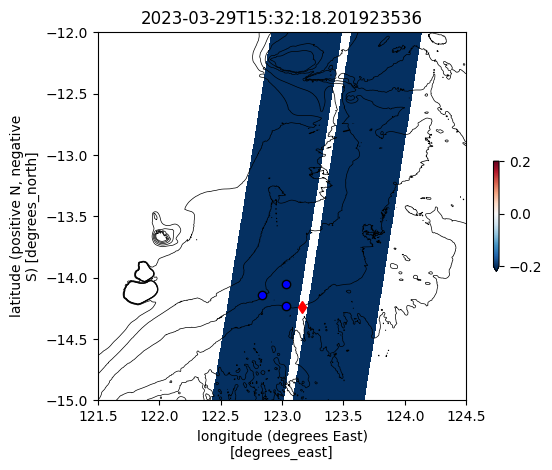

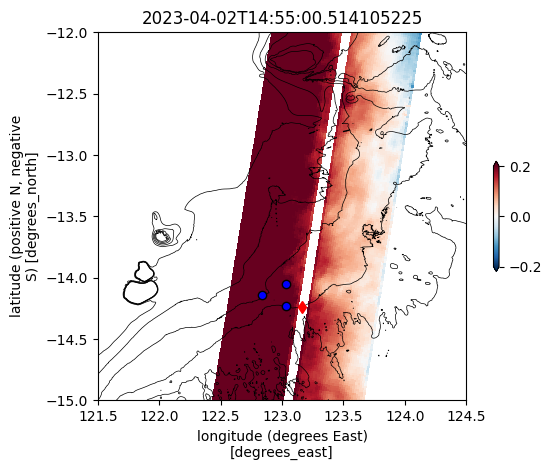

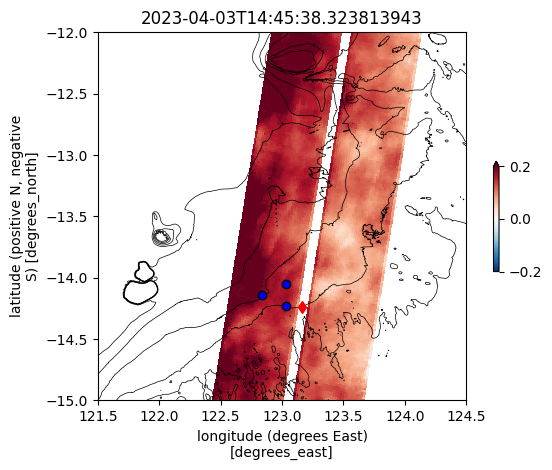

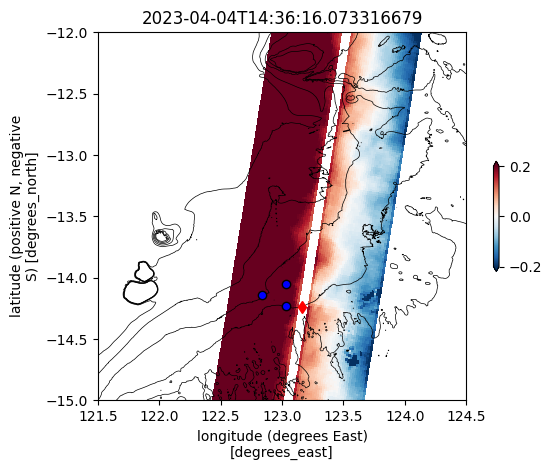

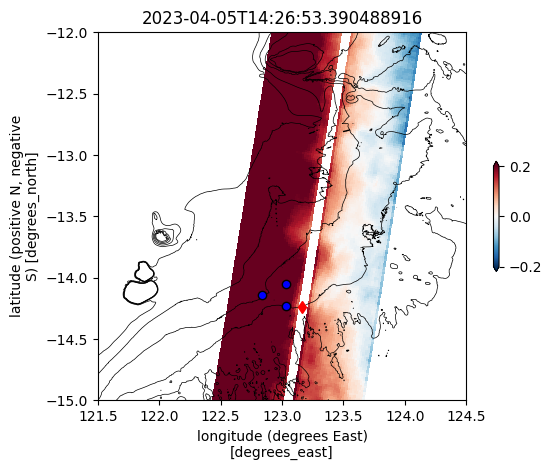

...

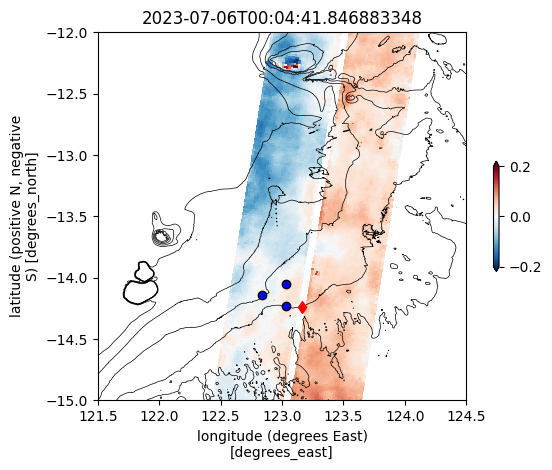

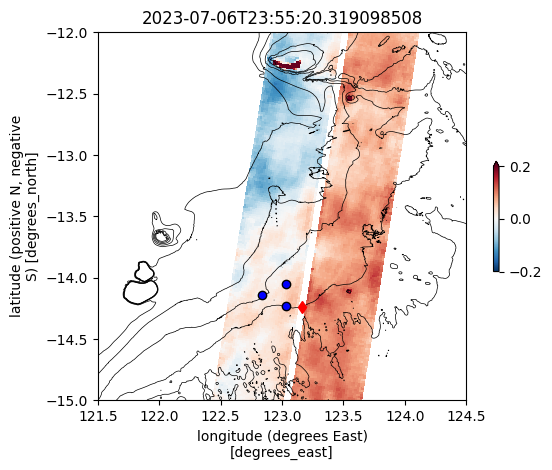

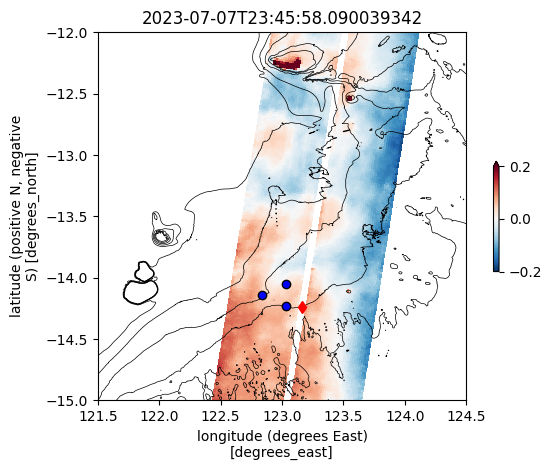

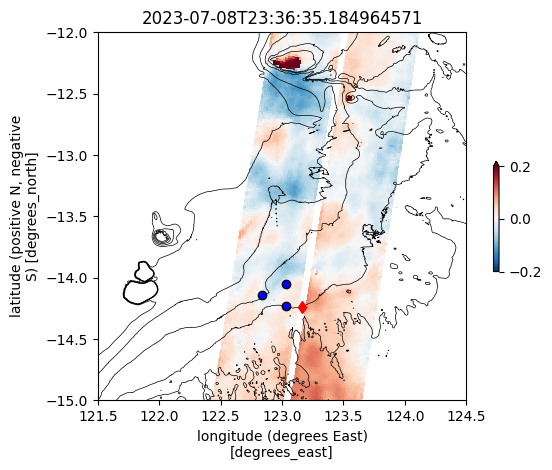

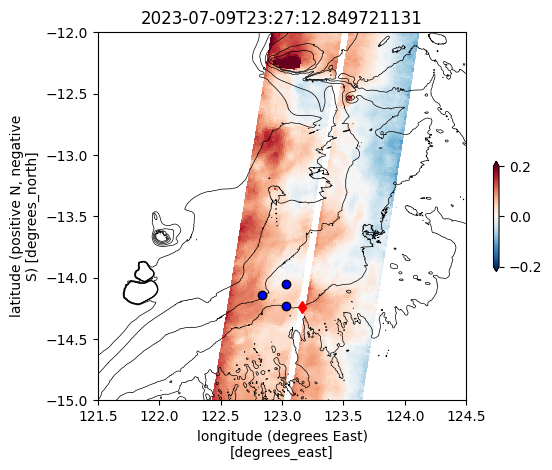

In [4]:
from utils import plot_swot_basemap

def plot_nicemap(ii):
    fig=plt.figure()
    ax=plt.subplot(111)
    plot_swot_basemap(ax, [121.5, 124.5], [-15, -12], swath=False) 
    
    data_corrected = calc_corrected_v2(ii, plot=False)
    
    plot_kwargs = dict(
    x="longitude",
    y="latitude",
    cmap="RdBu_r",
    vmin=-0.2,
    vmax=0.2,
    cbar_kwargs={"shrink": 0.3},)
    data_corrected.plot.pcolormesh(ax=ax, **plot_kwargs)
    ax.set_title(ds_area.satpass.values[ii])
    
    plt.tight_layout()

    outfile = '../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v2_{}.png'.format(ds_area.satpass.values[ii].astype(str)[0:10])
    print(outfile)
    plt.savefig(outfile, dpi=150)

    del fig
    del ax

for ii in range(88):
    plot_nicemap(ii)

In [ ]:
from utils import plot_swot_basemap

def plot_nicemap_v3(ii):
    fig=plt.figure()
    ax=plt.subplot(111)
    plot_swot_basemap(ax, [121.5, 124.5], [-15, -12], swath=False) 
    
    data_corrected = calc_corrected_v2(ii, plot=False)

    # Calc SSH gradients
    
    plot_kwargs = dict(
    x="longitude",
    y="latitude",
    cmap="RdBu_r",
    vmin=-0.2,
    vmax=0.2,
    cbar_kwargs={"shrink": 0.3},)
    data_corrected.plot.pcolormesh(ax=ax, **plot_kwargs)
    ax.set_title(ds_area.satpass.values[ii])
    
    plt.tight_layout()

    outfile = '../FIGURES/SWOT_Karin_BrowseBasin_nicemap_v3_{}.png'.format(ds_area.satpass.values[ii].astype(str)[0:10])
    print(outfile)
    plt.savefig(outfile, dpi=150)

    del fig
    del ax

for ii in range(88):
    plot_nicemap_v3(ii)

../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-03-29.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-02.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-03.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-04.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-05.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-06.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-07.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-08.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-09.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-10.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-11.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-12.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-14.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-15.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-16.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-17.png
../FIGUR

/tmp/ipykernel_202452/2656904838.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig=plt.figure()


../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-22.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-23.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-24.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-25.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-26.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-27.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-28.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-29.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-04-30.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-05-01.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-05-02.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-05-03.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-05-04.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-05-05.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-05-06.png
../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_2023-05-07.png
../FIGUR

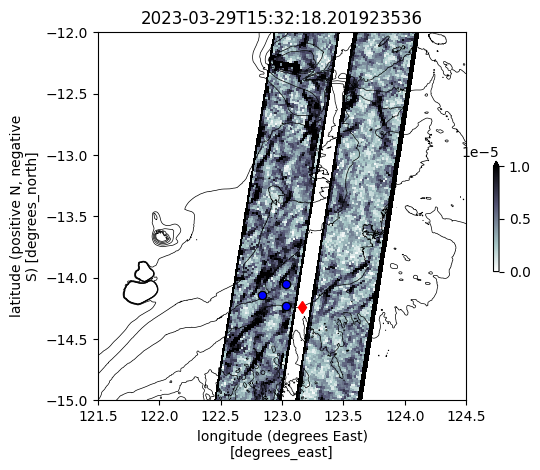

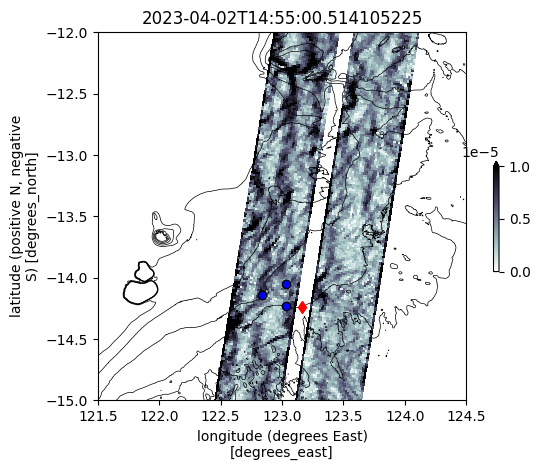

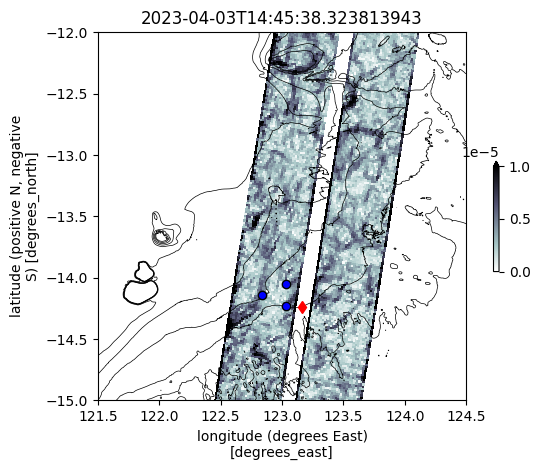

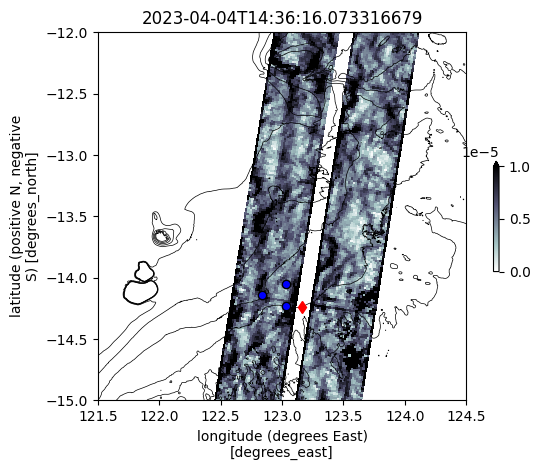

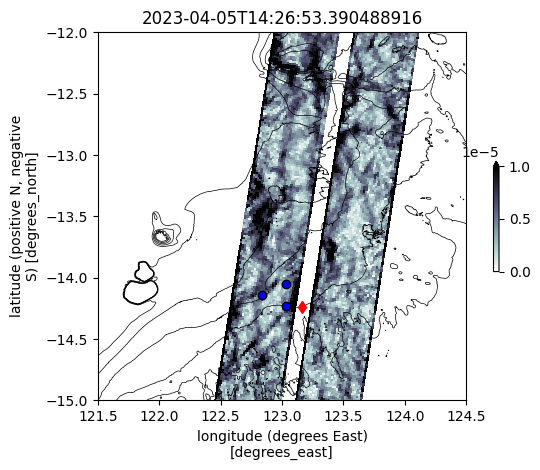

...

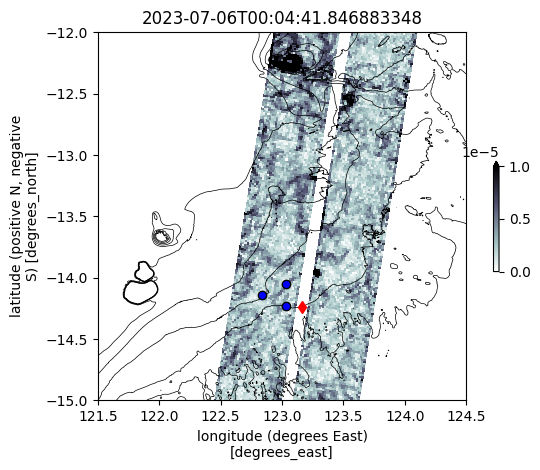

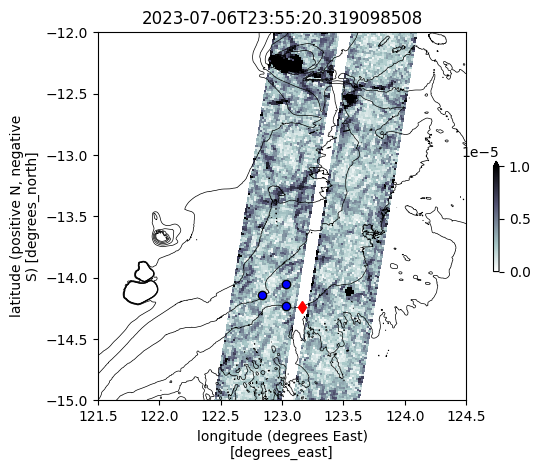

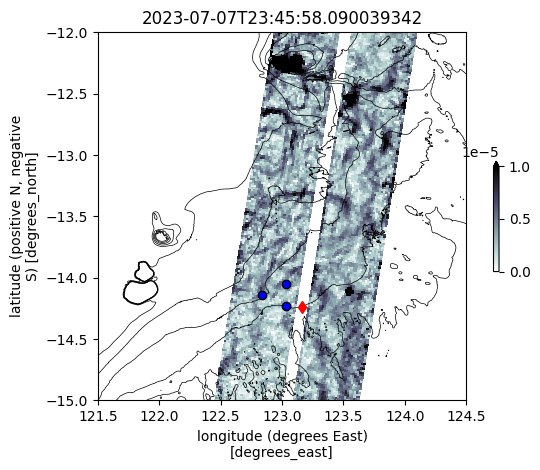

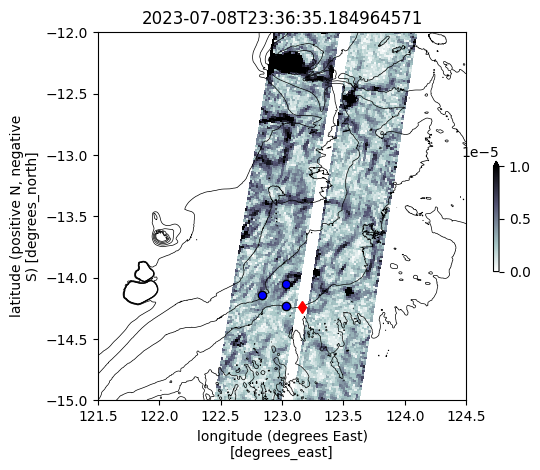

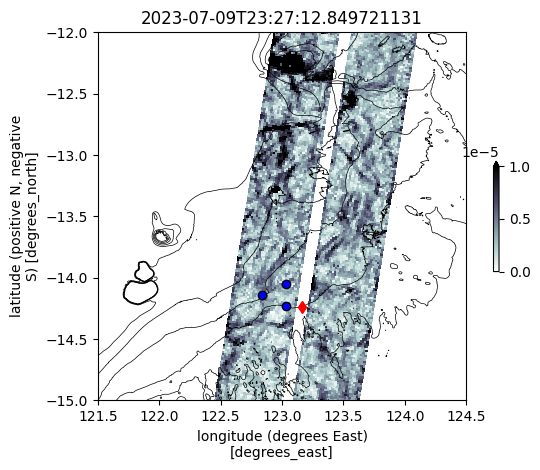

In [17]:
def plot_nicemap_grad(ii):

    data_corrected = calc_corrected_v2(ii, plot=False)
    
    dx, dy = np.gradient(data_corrected, 2000.)
    dssh_mag = np.abs(dx+1j*dy)
    
    ds_dssh_mag = data_corrected.copy()
    ds_dssh_mag[:] = dssh_mag
    
    fig=plt.figure()
    ax=plt.subplot(111)
    plot_swot_basemap(ax, [121.5, 124.5], [-15, -12], swath=False) 
    plot_kwargs = dict(
    x="longitude",
    y="latitude",
    cmap="bone_r",
    vmin=-0.,
    vmax=1e-5,
    cbar_kwargs={"shrink": 0.3},)
    ds_dssh_mag.plot.pcolormesh(ax=ax, **plot_kwargs)
    ax.set_title(ds_area.satpass.values[ii])

    plt.tight_layout()

    outfile = '../FIGURES/SWOT_Karin_BrowseBasin_nicemap_grad_{}.png'.format(ds_area.satpass.values[ii].astype(str)[0:10])
    print(outfile)
    plt.savefig(outfile, dpi=150)

    del fig
    del ax

for ii in range(88):
    plot_nicemap_grad(ii)

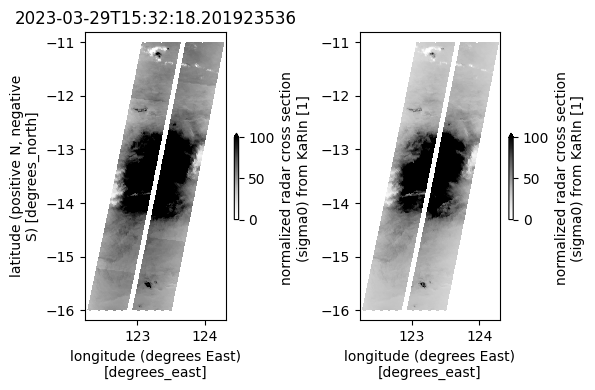

In [7]:
ii=0
var1, var2= 'sig0_karin', 'sig0_karin_2'
# var1, var2= 'ssh_karin', 'ssh_karin_2'

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 4))
plot_kwargs = dict(
x="longitude",
y="latitude",
cmap="Greys",
vmin=0,
vmax=100,
cbar_kwargs={"shrink": 0.3},)
ds_area.isel(satpass=ii)[var1].plot.pcolormesh(ax=ax1, **plot_kwargs)
ds_area.isel(satpass=ii)[var2].plot.pcolormesh(ax=ax2, **plot_kwargs)
ax1.set_title(ds_area.satpass.values[ii])
ax2.set_title('')
ax2.set_ylabel('')
plt.tight_layout()

In [ ]:
ii=16
var1, var2= 'ssh_karin_uncert', 'ssh_karin_uncert'
# var1, var2= 'ssh_karin', 'ssh_karin_2'

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 4))
plot_kwargs = dict(
x="longitude",
y="latitude",
cmap="Greys",
vmin=0,
vmax=0.005,
cbar_kwargs={"shrink": 0.3},)
ds_area.isel(satpass=ii)[var1].plot.pcolormesh(ax=ax1, **plot_kwargs)
ds_area.isel(satpass=ii)[var2].plot.pcolormesh(ax=ax2, **plot_kwargs)
ax1.set_title(ds_area.satpass.values[ii])
ax2.set_title('')
ax2.set_ylabel('')
plt.tight_layout()

In [ ]:
fig, ax1 = plt.subplots(1, 1, figsize=(3, 4))
plot_kwargs = dict(
x="longitude",
y="latitude",
cmap="Greys",
vmin=0,
vmax=70,
cbar_kwargs={"shrink": 0.3},)
ds_area.sigma0.plot.pcolormesh(ax=ax1, **plot_kwargs)
ax1.set_title(ds_area.time[0,0].values)
plt.tight_layout()